### Setup Tasks 

#### Install Latest Plotly

In [0]:
import plotly
plotly.__version__

'3.6.1'

In [0]:
!pip uninstall -q -y plotly
!pip install plotly==3.6.0

In [0]:
import plotly
plotly.__version__

'3.6.1'

In [0]:
def enable_plotly_in_cell():
  import IPython
  from plotly.offline import init_notebook_mode
  display(IPython.core.display.HTML('''
        <script src="/static/components/requirejs/require.js"></script>
  '''))
  init_notebook_mode(connected=False)

## Ingest

In [0]:
import pandas as pd

In [0]:
df = pd.read_csv(
    "https://raw.githubusercontent.com/noahgift/food/master/data/features.en.openfoodfacts.org.products.csv")
df.drop(["Unnamed: 0", "exceeded", "g_sum", "energy_100g"], axis=1, inplace=True) #drop two rows we don't need
df = df.drop(df.index[[1,11877]]) #drop outlier
df.rename(index=str, columns={"reconstructed_energy": "energy_100g"}, inplace=True)
df.head()

,fat_100g,carbohydrates_100g,sugars_100g,proteins_100g,salt_100g,energy_100g,product
0,28.57,64.29,14.29,3.57,0.00000,2267.85,Banana Chips Sweetened (Whole)
2,57.14,17.86,3.57,17.86,1.22428,2835.70,Organic Salted Nut Mix
3,18.75,57.81,15.62,14.06,0.13970,1953.04,Organic Muesli
4,36.67,36.67,3.33,16.67,1.60782,2336.91,Zen Party Mix
5,18.18,60.00,21.82,14.55,0.02286,1976.37,Cinnamon Nut Granola


In [0]:
df.drop(['product'], axis = 1).columns

Index(['fat_100g', 'carbohydrates_100g', 'sugars_100g', 'proteins_100g',
       'salt_100g', 'energy_100g'],
      dtype='object')

## EDA

In [0]:
df.describe()

,fat_100g,carbohydrates_100g,sugars_100g,proteins_100g,salt_100g,energy_100g,cluster
count,45026.000000,45026.000000,45026.000000,45026.000000,45026.000000,45026.000000,45026.000000
mean,10.765991,34.054064,16.005077,6.617261,1.469681,1111.286193,0.839115
std,14.930295,29.557393,21.495731,7.926242,12.795225,791.608595,0.892644
min,0.000000,0.000000,-1.200000,-3.570000,0.000000,0.000000,0.000000
25%,0.000000,7.440000,1.570000,0.000000,0.063500,334.520000,0.000000
50%,3.170000,22.390000,5.880000,4.000000,0.635000,1121.540000,1.000000
75%,17.860000,61.540000,23.080000,9.520000,1.440180,1678.460000,2.000000
max,100.000000,100.000000,100.000000,100.000000,2032.000000,4475.000000,2.000000


## Principal component analysis

### Checking correlations

In [0]:
df.drop(['product'], axis = 1).head()

,fat_100g,carbohydrates_100g,sugars_100g,proteins_100g,salt_100g,energy_100g
0,28.57,64.29,14.29,3.57,0.00000,2267.85
2,57.14,17.86,3.57,17.86,1.22428,2835.70
3,18.75,57.81,15.62,14.06,0.13970,1953.04
4,36.67,36.67,3.33,16.67,1.60782,2336.91
5,18.18,60.00,21.82,14.55,0.02286,1976.37


In [0]:
df.drop(['product'], axis = 1).corr()

,fat_100g,carbohydrates_100g,sugars_100g,proteins_100g,salt_100g,energy_100g
fat_100g,1.000000,-0.051426,-0.068140,0.383442,-0.002683,0.768193
carbohydrates_100g,-0.051426,1.000000,0.669234,-0.096910,-0.011442,0.580429
sugars_100g,-0.068140,0.669234,1.000000,-0.277389,-0.030346,0.327460
proteins_100g,0.383442,-0.096910,-0.277389,1.000000,0.015611,0.390751
salt_100g,-0.002683,-0.011442,-0.030346,0.015611,1.000000,-0.006579
energy_100g,0.768193,0.580429,0.327460,0.390751,-0.006579,1.000000


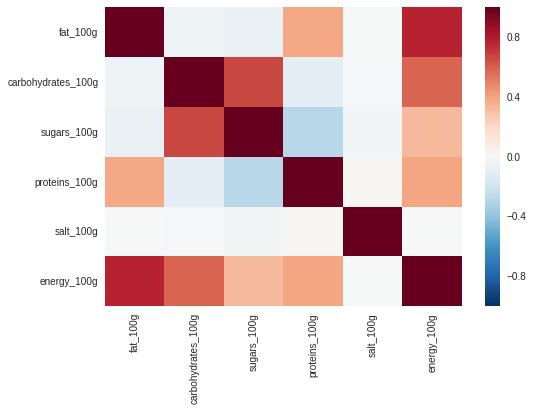

In [0]:
import seaborn as sns
sns.heatmap(df.drop(['product'], axis = 1).corr())

### Checking components

In [0]:
original_components = df.drop(['product'], axis = 1).values

In [0]:
from sklearn.decomposition import PCA 
  
pca = PCA(n_components = 3)
transormed = pca.fit_transform(original_components)

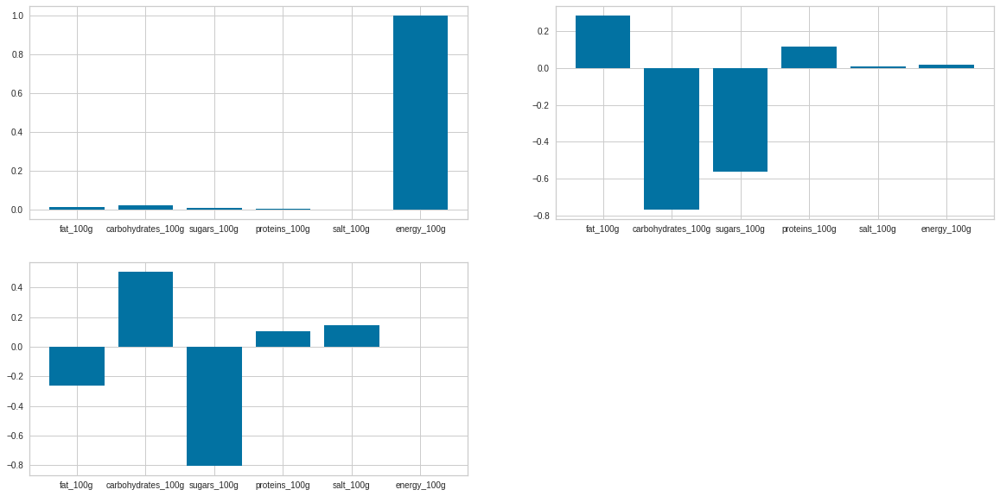

<Figure size 576x396 with 0 Axes>

In [0]:
fig = plt.figure(figsize = (20,10))

plt.subplot(2, 2, 1)
plt.bar(df.drop(['product'], axis = 1).columns,pca.components_[0])

plt.subplot(2, 2, 2)
plt.bar(df.drop(['product'], axis = 1).columns,pca.components_[1])

plt.subplot(2, 2, 3)
plt.bar(df.drop(['product'], axis = 1).columns,pca.components_[2])

# plt.subplot(2, 2, 4)
# plt.bar(df.drop(['product'], axis = 1).columns,pca.components_[3])

plt.show()
plt.tight_layout()

In [0]:
df_pca = pd.DataFrame(transormed, columns = ['high_energy', 'low_carbs_low_sugar', 'high_carbs_low_sugar_balanced'])

In [0]:
df_pca = pd.concat([df[['product']].reset_index(), df_pca], axis =1 ).drop(['index'], axis = 1)

In [0]:
df_pca.head(5)

,product,high_energy,low_carbs_low_sugar,high_carbs_low_sugar_balanced
0,Banana Chips Sweetened (Whole),1157.002307,2.187805,10.979330
1,Organic Salted Nut Mix,1723.999580,63.364721,-10.092472
2,Organic Muesli,842.084358,-0.500709,10.449601
3,Zen Party Mix,1225.507404,34.597462,5.175813
4,Cinnamon Nut Granola,865.501680,-5.372377,6.767135


## Visualizations

### Histogram

Generate distributions based on energy type

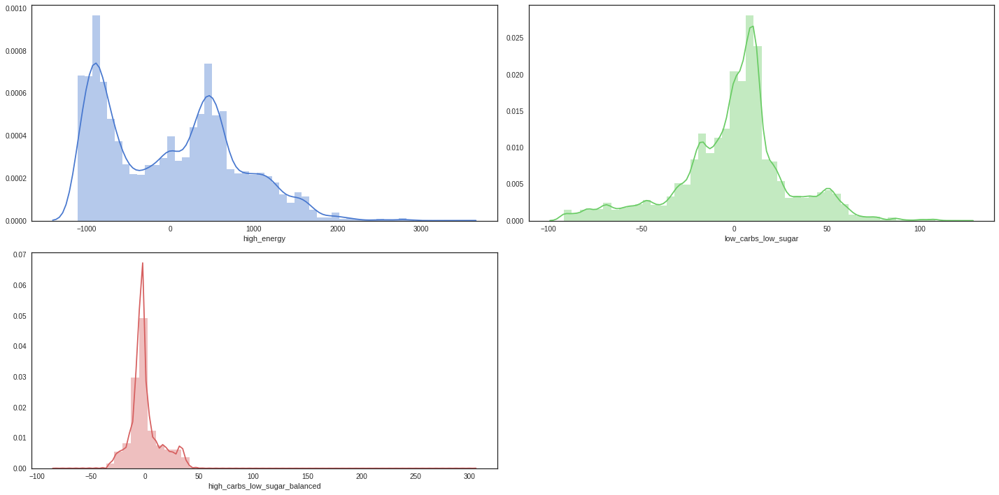

In [0]:
import seaborn as sns
import matplotlib.pyplot as plt
import warnings
import matplotlib.cbook
warnings.filterwarnings("ignore",category=matplotlib.cbook.mplDeprecation)
sns.set(style="white", palette="muted", color_codes=True)

fig = plt.figure(figsize = (20,10))


plt.subplot(2, 2, 1)
sns.distplot(df_pca.high_energy, color="b")

plt.subplot(2, 2, 2)
sns.distplot(df_pca.low_carbs_low_sugar, color="g")

plt.subplot(2, 2, 3)
sns.distplot(df_pca.high_carbs_low_sugar_balanced, color="r")
plt.tight_layout()


### Word Cloud

In [0]:
from wordcloud import WordCloud, STOPWORDS
import matplotlib.pyplot as plt

#### High energy foods

Find protein foods in the 98th percentile

In [0]:
high_energy_df = df_pca[df_pca.high_energy > df_pca.high_energy.quantile(.98)]
high_energy_text = high_energy_df['product'].values
len(high_energy_text)

901

Word Cloud High Protein

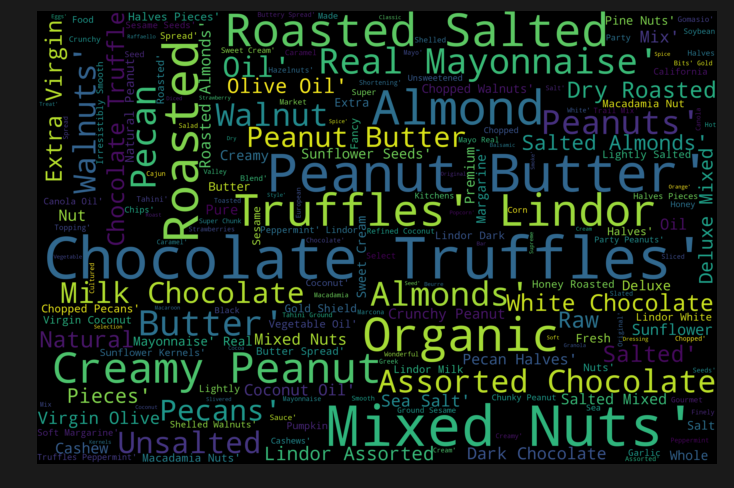

In [0]:
wordcloud = WordCloud(
    width = 3000,
    height = 2000,
    background_color = 'black',
    stopwords = STOPWORDS).generate(str(high_energy_text))

fig = plt.figure(
    figsize = (10, 7),
    facecolor = 'k',
    edgecolor = 'k')
plt.imshow(wordcloud, interpolation = 'bilinear')
plt.axis('off')
plt.tight_layout(pad=0)
plt.show()

#### Low Carbs low sugar foods

Find fatty foods in the 98th percentile

In [0]:
low_carbs_low_sugar_df = df_pca[df_pca.low_carbs_low_sugar > df_pca.low_carbs_low_sugar.quantile(.98)]
low_carbs_low_sugar_text = low_carbs_low_sugar_df['product'].values
len(low_carbs_low_sugar_text)

897

Word Cloud High Fat

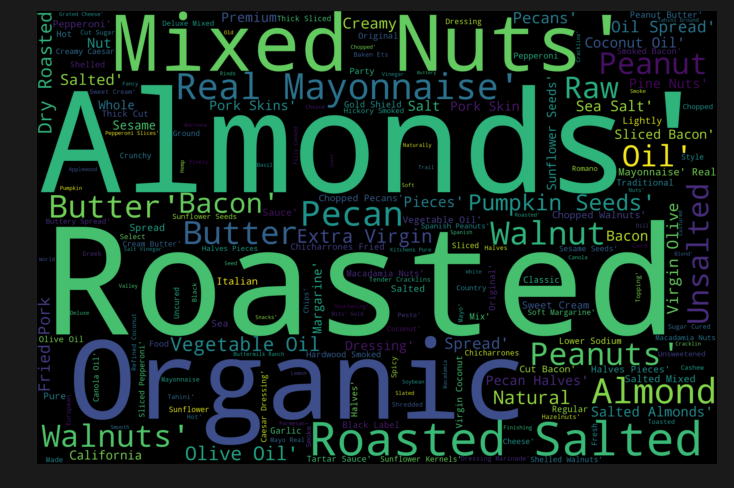

In [0]:
wordcloud = WordCloud(
    width = 3000,
    height = 2000,
    background_color = 'black',
    stopwords = STOPWORDS).generate(str(low_carbs_low_sugar_text))

fig = plt.figure(
    figsize = (10, 7),
    facecolor = 'k',
    edgecolor = 'k')
plt.imshow(wordcloud, interpolation = 'bilinear')
plt.axis('off')
plt.tight_layout(pad=0)
plt.show()

## Clustering

In [0]:
df_pca.columns

Index(['product', 'high_energy', 'low_carbs_low_sugar',
       'high_carbs_low_sugar_balanced'],
      dtype='object')

### Create Features to Cluster

In [0]:
df_cluster_features = df_pca.drop("product", axis=1)

### Scale the data

In [0]:
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
print(scaler.fit(df_cluster_features))
print(scaler.transform(df_cluster_features))

MinMaxScaler(copy=True, feature_range=(0, 1))
[[5.07049306e-01 4.41147495e-01 2.41957976e-01]
 [6.33758190e-01 7.28830718e-01 1.87188750e-01]
 [4.36673479e-01 4.28504815e-01 2.40581120e-01]
 ...
 [5.07184307e-02 4.23539082e-01 1.97739431e-01]
 [6.18273197e-02 4.09269679e-01 1.95451933e-01]
 [5.59263473e-06 4.88678189e-01 2.08167412e-01]]


#### Cluster Diagnostics

**Three **clusters seem ideal

##### Yellowbrick Visualizer Elbow Method

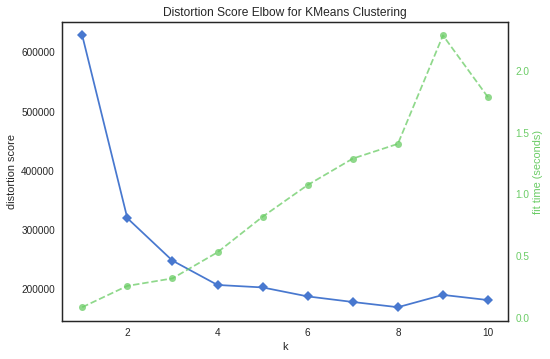

In [0]:
from sklearn.cluster import KMeans
from yellowbrick.cluster import KElbowVisualizer

# Instantiate the clustering model and visualizer
model = KMeans()
visualizer = KElbowVisualizer(model, k=(1,11))

visualizer.fit(df_cluster_features)    # Fit the data to the visualizer
visualizer.poof()    # Draw/show/poof the data

##### Yellowbrick Silhouette Visualizer


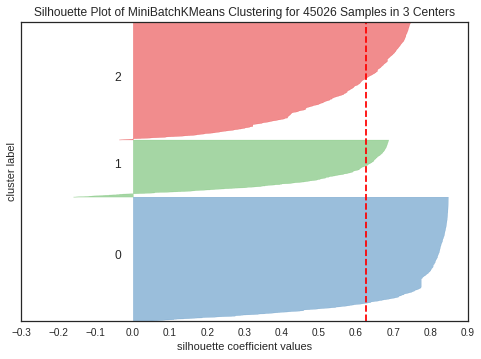

In [0]:
from sklearn.cluster import MiniBatchKMeans

from yellowbrick.cluster import SilhouetteVisualizer

# Instantiate the clustering model and visualizer
model = MiniBatchKMeans(3)
visualizer = SilhouetteVisualizer(model)

visualizer.fit(df_cluster_features) # Fit the training data to the visualizer
visualizer.poof() # Draw/show/poof the data

### Add Cluster Labels

In [0]:
from sklearn.cluster import KMeans

k_means = KMeans(n_clusters=3)
kmeans = k_means.fit(scaler.transform(df_cluster_features))
df_pca['cluster'] = kmeans.labels_
df_pca.head()

,product,high_energy,low_carbs_low_sugar,high_carbs_low_sugar_balanced,cluster
0,Banana Chips Sweetened (Whole),1157.002307,2.187805,10.979330,2
1,Organic Salted Nut Mix,1723.999580,63.364721,-10.092472,2
2,Organic Muesli,842.084358,-0.500709,10.449601,0
3,Zen Party Mix,1225.507404,34.597462,5.175813,2
4,Cinnamon Nut Granola,865.501680,-5.372377,6.767135,0


## 3D ClusterPlot

#### Protein-Fat-Carb 3D Plot

In [0]:
import plotly.offline as py
import plotly.graph_objs as go

from plotly.offline import init_notebook_mode
enable_plotly_in_cell()


trace1 = go.Scatter3d(
    x=df_pca["high_energy"],
    y=df_pca["low_carbs_low_sugar"],
    z=df_pca["high_carbs_low_sugar_balanced"],
    mode='markers',
    text=df_pca["product"],
    marker=dict(
        size=12,
        color=df["cluster"],                # set color to an array/list of desired values
        colorscale='Viridis',   # choose a colorscale
        opacity=0.8
    )
)
#print(trace1)
data = [trace1]
layout = go.Layout(
    showlegend=False,
    title="Food types",
    scene = dict(
        xaxis = dict(title='X: High energy'),
        yaxis = dict(title="Y:  Low carbs and low sugar"),
        zaxis = dict(title="Z:  High carbs and low sugar, balanced"),
    ),
    width=1000,
    height=900,
)
fig = go.Figure(data=data, layout=layout)
py.iplot(fig, filename='3d-scatter-colorscale')